# Análise de dados

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

## Homicídios (2017-2022)

In [17]:
df_homicidios = pd.read_excel("df_homicidios_2017-2022.xlsx")

### Quais são as 5 cidades com o maior número de homicídio?



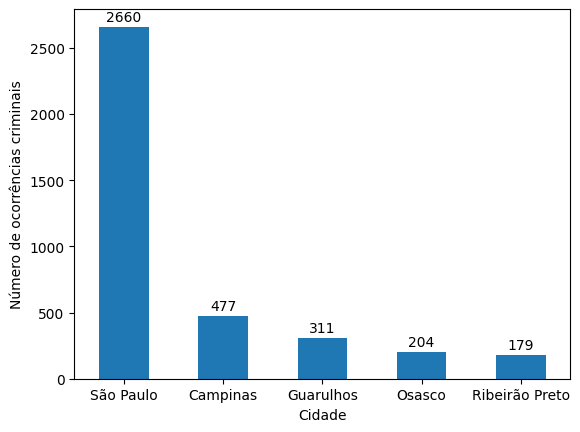

In [18]:
# cria um gráfico de barras com os dados
homicidios_por_cidade = df_homicidios['MUNICIPIO_CIRCUNSCRICAO'].value_counts()
homicidios_por_cidade_TOP_5 = homicidios_por_cidade.head()
ax = homicidios_por_cidade_TOP_5.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Cidade')
plt.ylabel('Número de ocorrências criminais')
plt.xticks(rotation=0)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()


### Quantidade de homicídio por ano

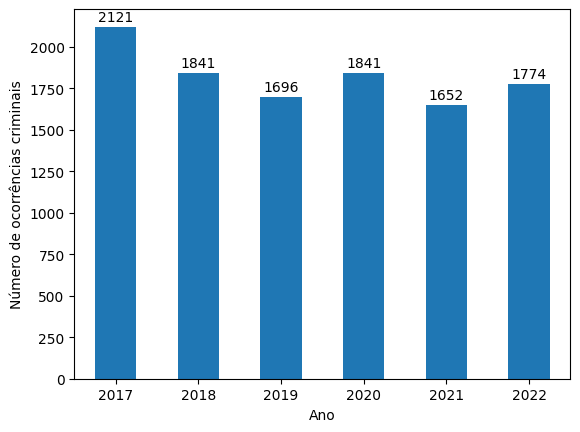

In [85]:
# cria um gráfico de barras com os dados
homicidios_por_ano = df_homicidios['ANO_BO'].value_counts()
homicidios_por_ano = homicidios_por_ano.sort_index()
ax = homicidios_por_ano.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Ano')
plt.ylabel('Número de ocorrências criminais')
plt.xticks(rotation=0)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()


### Em quais locais ocorreram o maior número de homicídios?

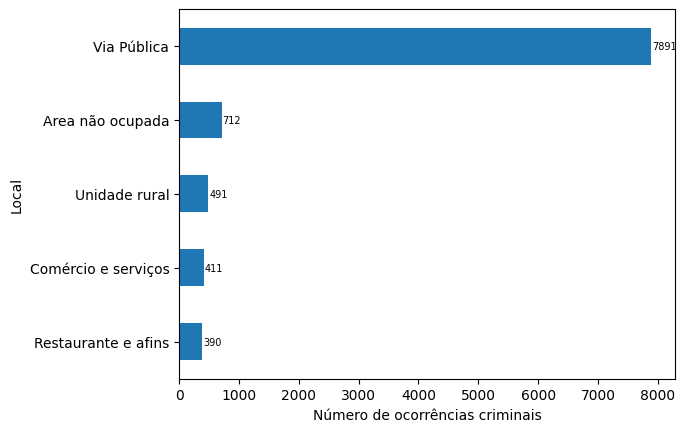

In [144]:
# cria um gráfico de barras com os dados
homicidios_por_local = df_homicidios['DESC_TIPOLOCAL'].value_counts()
homicidios_por_local_TOP5 = homicidios_por_local.head()
homicidios_por_local_TOP5 = homicidios_por_local_TOP5.sort_values()
ax = homicidios_por_local_TOP5.plot(kind='barh')

# adiciona rótulos aos eixos
plt.xlabel('Número de ocorrências criminais')
plt.ylabel('Local')

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=7, padding=0.5)
    
# exibe o gráfico
plt.show()


### Quais meses foram registrados mais crimes (2017-2022)?

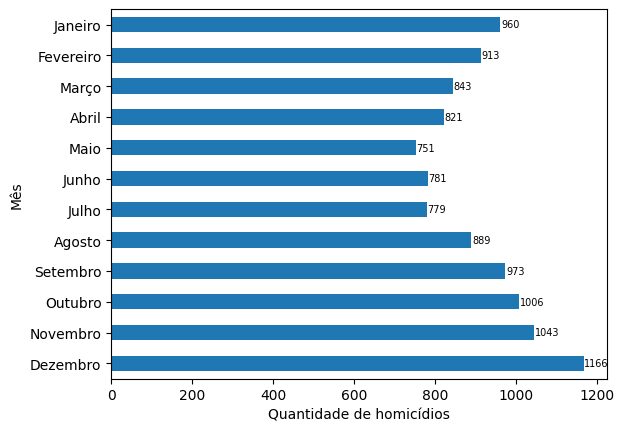

In [145]:
# cria um gráfico de barras com os dados
homicidios_por_mes = df_homicidios['MES_ESTATISTICA'].value_counts()
homicidios_por_mes = homicidios_por_mes.sort_index(ascending=False)
ax = homicidios_por_mes.plot(kind='barh')

# adiciona rótulos aos eixos
plt.xlabel('Quantidade de homicídios')
plt.ylabel('Mês')

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=7, padding=0.5)

# define os novos labels para os meses
meses = {1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho',
         7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'}
novos_rotulos = [meses[x] for x in homicidios_por_mes.index]

# atualiza os labels do eixo y
ax.set_yticklabels(novos_rotulos)
    
# exibe o gráfico
plt.show()


### Comparando o número de ocorrências por mês e por ano

In [39]:
tabela = pd.crosstab(columns=df_homicidios['ANO_ESTATISTICA'], index=df_homicidios['MES_ESTATISTICA'])
tabela

ANO_ESTATISTICA,2017,2018,2019,2020,2021,2022
MES_ESTATISTICA,,,,,,
1,170,158,177,149,169,137
2,185,164,126,136,149,153
3,159,151,129,175,105,124
4,157,137,126,146,122,133
5,153,120,103,125,135,115
6,129,141,115,133,133,130
7,174,141,105,118,106,135
8,171,133,133,150,140,162
9,178,160,148,156,162,169


In [41]:
tabela_1semestre = tabela.loc[1:6]
tabela_2semestre = tabela.loc[7:12]

#### 1° semestre

<Figure size 1000x600 with 0 Axes>

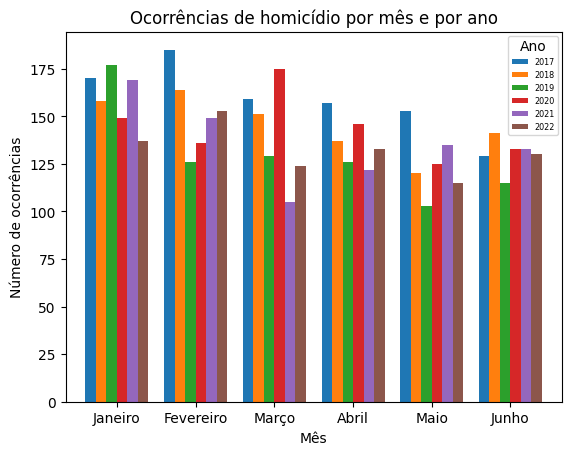

In [54]:
# define o tamanho do gráfico
plt.figure(figsize=(10, 6))

# cria o gráfico de barras agrupadas
ax = tabela_1semestre.plot(kind='bar', width=0.8, position=0.5)

# adiciona rótulos aos eixos e ao gráfico
plt.xlabel('Mês', rotation=0)
plt.ylabel('Número de ocorrências')
plt.title('Ocorrências de homicídio por mês e por ano')
plt.legend(title='Ano', loc='best', fontsize='xx-small')

# define os novos labels para os meses
meses = {1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho'}
novos_rotulos = [meses[x] for x in tabela_1semestre.index]

# atualiza os labels do eixo x
ax.set_xticklabels(novos_rotulos)
plt.xticks(rotation=0)

# exibe o gráfico
plt.show()

#### 2° semestre

<Figure size 1000x600 with 0 Axes>

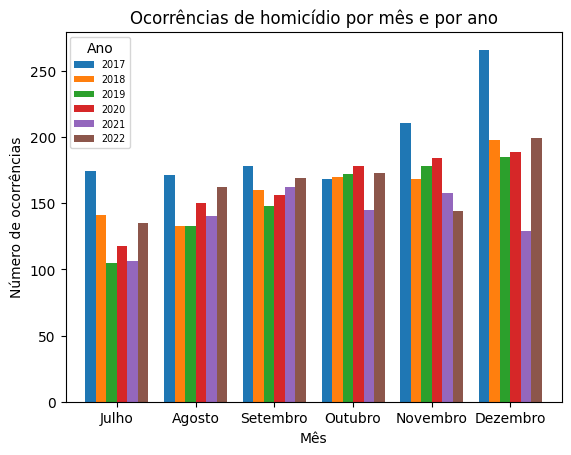

In [61]:
# define o tamanho do gráfico
plt.figure(figsize=(10, 6))

# cria o gráfico de barras agrupadas
ax = tabela_2semestre.plot(kind='bar', width=0.8, position=0.5)

# adiciona rótulos aos eixos e ao gráfico
plt.xlabel('Mês', rotation=0)
plt.ylabel('Número de ocorrências')
plt.title('Ocorrências de homicídio por mês e por ano')
plt.legend(title='Ano', loc='upper left', fontsize='x-small')

# define os novos labels para os meses
meses = {7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'}
novos_rotulos = [meses[x] for x in tabela_2semestre.index]

# atualiza os labels do eixo x
ax.set_xticklabels(novos_rotulos)
plt.xticks(rotation=0)

# exibe o gráfico
plt.show()

## Furto de veículos (2017-2022)

In [63]:
df_furtos_veiculos = pd.read_excel("df_furtos_veiculos_2017_2022.xlsx")
df_furtos_veiculos

,ANO_BO,NUM_BO,NUMERO_BOLETIM,BO_INICIADO,BO_EMITIDO,DATAOCORRENCIA,HORAOCORRENCIA,PERIDOOCORRENCIA,DATACOMUNICACAO,DATAELABORACAO,...,ESPECIE,RUBRICA,STATUS,UF_VEICULO,CIDADE_VEICULO,DESCR_COR_VEICULO,DESCR_MARCA_VEICULO,ANO_FABRICACAO,ANO_MODELO,DESCR_TIPO_VEICULO
0,2017,1603408,1603408/2017,2017-12-01 00:14:00,2017-12-01 00:14:00,2017-11-30 00:00:00,19:00:00,A NOITE,2017-11-30,2017-01-12 00:14:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,S.PAULO,Preta,I/VW JETTA,2009,2010,AUTOMOVEL
1,2017,1603292,1603292/2017,2017-12-01 00:16:00,2017-12-01 00:16:00,2017-11-30 00:00:00,21:00:00,A NOITE,2017-11-30,2017-01-12 00:16:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,POA,Vermelho,HONDA/CG 125 FAN,2006,2007,MOTOCICLO
2,2017,1603518,1603518/2017,2017-12-01 00:27:00,2017-12-01 00:27:00,2017-11-30 00:00:00,19:00:00,A NOITE,2017-11-30,2017-01-12 00:27:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,JABOTICABAL,Preta,FORD/FIESTA 1.6 FLEX,2008,2009,AUTOMOVEL
3,2017,1603527,1603527/2017,2017-12-01 00:34:00,2017-12-01 00:34:00,2017-11-30 00:00:00,20:00:00,A NOITE,2017-11-30,2017-01-12 00:34:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,S.PAULO,Prata,HYUNDAI/TUCSON GLSB,2011,2012,CAMIONETA
4,2017,1603443,1603443/2017,2017-12-01 00:35:00,2017-12-01 00:35:00,2017-11-30 00:00:00,22:00:00,A NOITE,2017-11-30,2017-01-12 00:35:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,CAMPINAS,Prata,HONDA/FIT EX,2006,2007,AUTOMOVEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40929,2022,7654,7654/2022,2022-12-29 22:03:00,2022-12-29 22:03:00,2022-12-29 00:00:00,17:30:00,A TARDE,2022-12-29,2022-12-29 22:03:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,BAURU,Prata,TOYOTA ETIOS HB X,2014,2015,AUTOMOVEL
40930,2022,3394,3394/2022,2022-12-29 22:30:00,2022-12-29 22:30:00,2022-12-29 00:00:00,14:56:00,A TARDE,2022-12-29,2022-12-29 22:30:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,JABOTICABAL,Vermelho,M.A./MASSEY-FERGUSON,2006,2007,TRATOR RODAS
40931,2022,3394,3394/2022,2022-12-29 22:30:00,2022-12-29 22:30:00,2022-12-29 00:00:00,14:56:00,A TARDE,2022-12-29,2022-12-29 22:30:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,JABOTICABAL,Vermelho,M.A./MASSEY-FERGUSON,2021,2022,TRATOR RODAS
40932,2022,3394,3394/2022,2022-12-29 22:30:00,2022-12-29 22:30:00,2022-12-29 00:00:00,14:56:00,A TARDE,2022-12-29,2022-12-29 22:30:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,MG,BELO HORIZONTE,Branco,RENAULT/KWID ZEN 10MT,2021,2022,AUTOMOVEL


### Quais são as 5 cidades com o maior número de furtos de veículos?



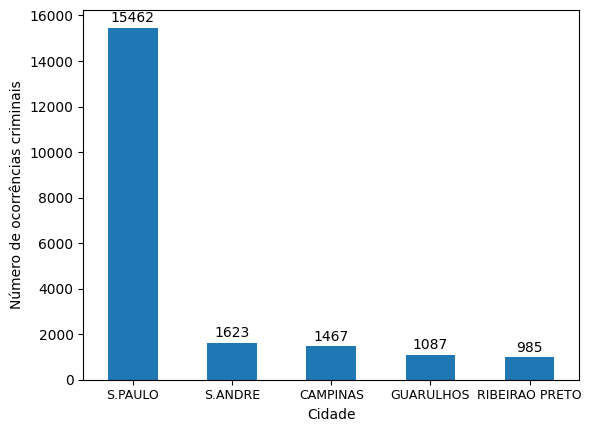

In [70]:
furtos_veiculos_por_cidade = df_furtos_veiculos['CIDADE'].value_counts()
furtos_veiculos_por_cidade_TOP_5 = furtos_veiculos_por_cidade.head()
ax = furtos_veiculos_por_cidade_TOP_5.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Cidade')
plt.ylabel('Número de ocorrências criminais')
plt.xticks(rotation=0, fontsize=9)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()


### Qual foi o momento do dia mais frequente que ocorreram os furtos de veículos?

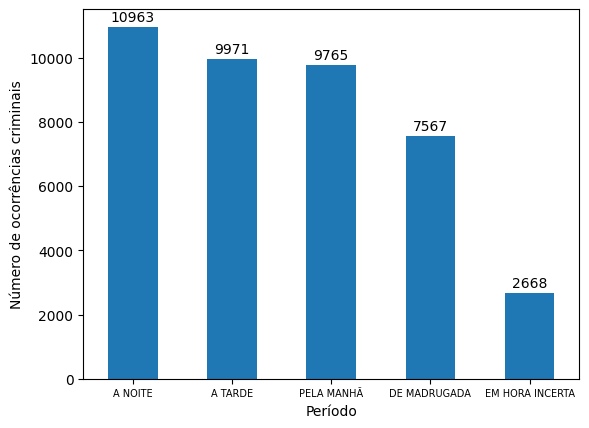

In [93]:
# cria um gráfico de barras com os dados
furtos_veiculos_por_periodo = df_furtos_veiculos['PERIDOOCORRENCIA'].value_counts()
ax = furtos_veiculos_por_periodo.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Período')
plt.ylabel('Número de ocorrências criminais')
plt.xticks(rotation=0, fontsize=7)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()


### Quantidade de furtos de veículos por ano

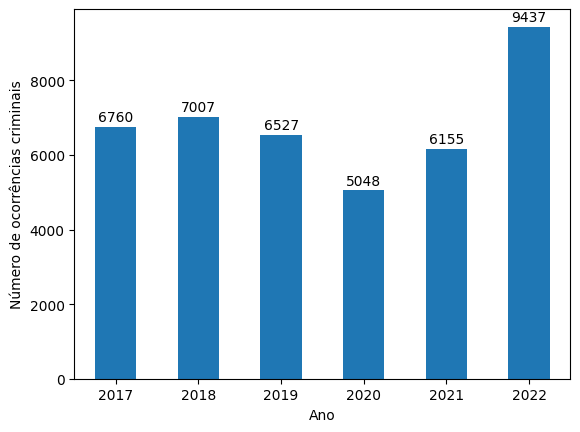

In [73]:
# cria um gráfico de barras com os dados
furtos_veiculos_por_ano = df_furtos_veiculos['ANO_BO'].value_counts()
furtos_veiculos_por_ano = furtos_veiculos_por_ano.sort_index()
ax = furtos_veiculos_por_ano.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Ano')
plt.ylabel('Número de ocorrências criminais')
plt.xticks(rotation=0)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()


### Quantos porcento dos furtos de veículos foram pegos em flagrante?

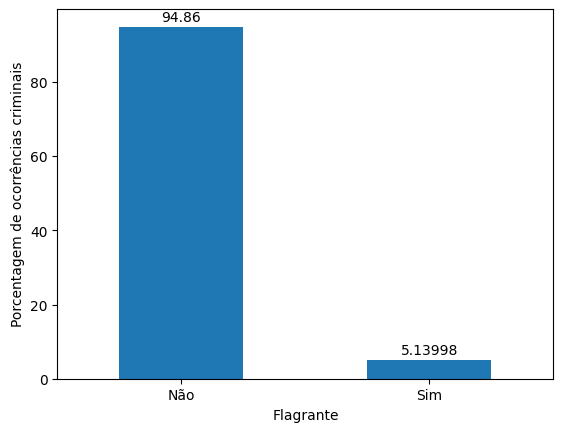

In [114]:
furtos_veiculos_flagrante = df_furtos_veiculos['FLAGRANTE'].value_counts(normalize=True) * 100
ax = furtos_veiculos_flagrante.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Flagrante')
plt.ylabel('Porcentagem de ocorrências criminais')
plt.xticks(rotation=0)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()

### Quantos porcento dos furtos de veículos foram realmente consumados?

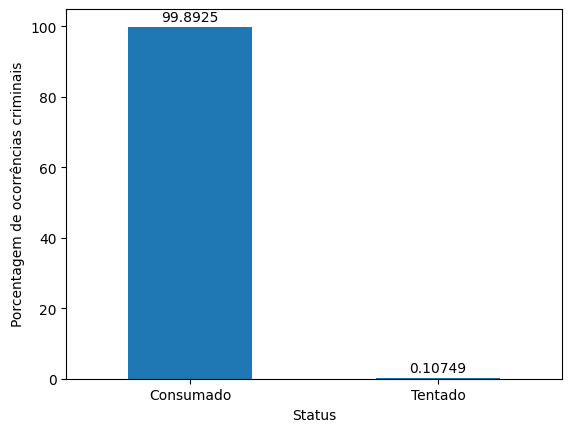

In [115]:
furtos_veiculos_status = df_furtos_veiculos['STATUS'].value_counts(normalize=True) * 100
ax = furtos_veiculos_status.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Status')
plt.ylabel('Porcentagem de ocorrências criminais')
plt.xticks(rotation=0)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=10, padding=2)
    
# exibe o gráfico
plt.show()

### Em quais locais ocorreram o maior número de furtos de veículos?

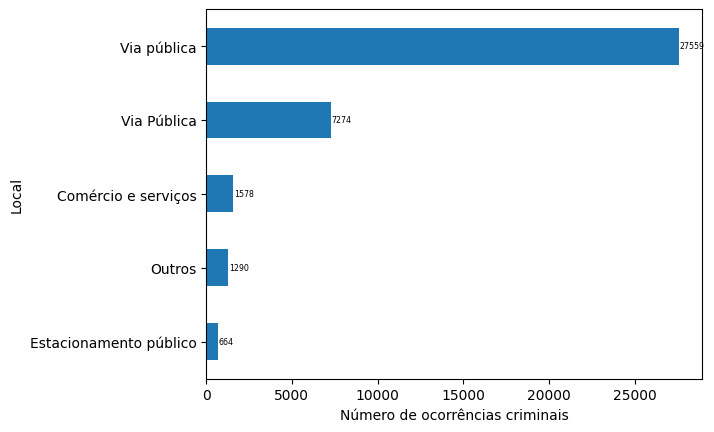

In [121]:
# cria um gráfico de barras com os dados
furtos_veiculos_por_local = df_furtos_veiculos['DESCRICAOLOCAL'].value_counts()
furtos_veiculos_por_local_TOP5 = furtos_veiculos_por_local.head()
furtos_veiculos_por_local_TOP5 = furtos_veiculos_por_local_TOP5.sort_values()
ax = furtos_veiculos_por_local_TOP5.plot(kind='barh')

# adiciona rótulos aos eixos
plt.xlabel('Número de ocorrências criminais')
plt.ylabel('Local')

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=5.7, padding=0.5)
    
# exibe o gráfico
plt.show()


### Tipo do veículo mais furtado

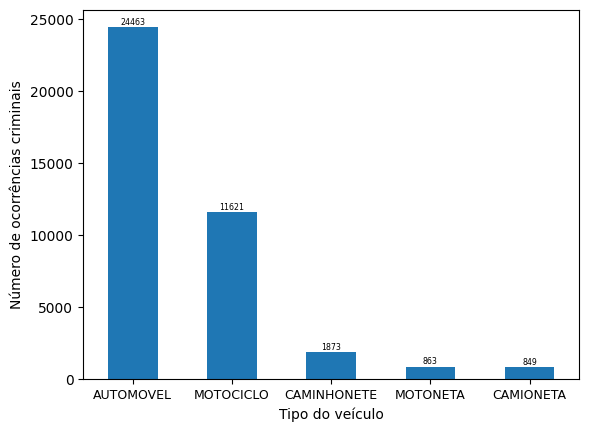

In [129]:
# cria um gráfico de barras com os dados
furtos_veiculos_por_marca = df_furtos_veiculos['DESCR_TIPO_VEICULO'].value_counts()
furtos_veiculos_por_marca_TOP5 = furtos_veiculos_por_marca.head()
ax = furtos_veiculos_por_marca_TOP5.plot(kind='bar')

# adiciona rótulos aos eixos
plt.xlabel('Tipo do veículo')
plt.ylabel('Número de ocorrências criminais')
plt.xticks(rotation=0, fontsize=9)

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=5.7, padding=0.5)
    
# exibe o gráfico
plt.show()


### Marca do veículo mais furtado

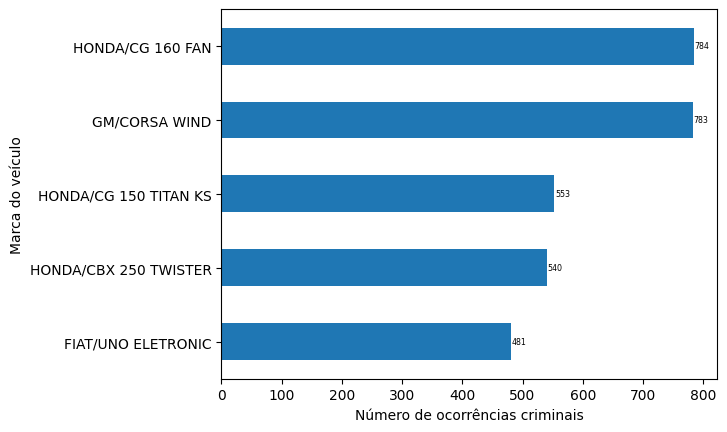

In [124]:
# cria um gráfico de barras com os dados
furtos_veiculos_por_marca = df_furtos_veiculos['DESCR_MARCA_VEICULO'].value_counts()
furtos_veiculos_por_marca_TOP5 = furtos_veiculos_por_marca.head()
furtos_veiculos_por_marca_TOP5 = furtos_veiculos_por_marca_TOP5.sort_values()
ax = furtos_veiculos_por_marca_TOP5.plot(kind='barh')

# adiciona rótulos aos eixos
plt.xlabel('Número de ocorrências criminais')
plt.ylabel('Marca do veículo')

# adiciona a quantidade de cada coluna ao gráfico
for i in ax.containers:
    ax.bar_label(i, label_type='edge', fontsize=5.7, padding=0.5)
    
# exibe o gráfico
plt.show()




1.   Motocicleta
2.   Automóveis
3.   Motocicleta
4.   Motocicleta
5.   Automóveis



# Mapas
## Homicídio (2017-2022)

In [20]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

In [21]:
df_homicidios = pd.read_excel("df_homicidios_2017-2022.xlsx")

In [22]:
# criar mapa
map = folium.Map(location=[-23.98431381174277, -46.306417588652266], zoom_start=9)

# criar objeto MarkerCluster
marker_cluster = MarkerCluster().add_to(map)

# criar dicionário de cores para os municípios
colors = {
    2017: 'red',
    2018: 'blue',
    2019: 'green',
    2020: 'pink',
    2021: 'orange',
    2022: 'purple',
    2023: 'yellow'
}

# adicionar marcadores ao mapa
for i, row in df_homicidios.iterrows():
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        icon=folium.Icon(color=colors[row['ANO_BO']])
    ).add_to(marker_cluster)

map


## Furtos de veículos (2017-2022)

In [23]:
df_furtos_veiculos = pd.read_excel("df_furtos_veiculos_2017_2022.xlsx")
df_furtos_veiculos

,ANO_BO,NUM_BO,NUMERO_BOLETIM,BO_INICIADO,BO_EMITIDO,DATAOCORRENCIA,HORAOCORRENCIA,PERIDOOCORRENCIA,DATACOMUNICACAO,DATAELABORACAO,...,ESPECIE,RUBRICA,STATUS,UF_VEICULO,CIDADE_VEICULO,DESCR_COR_VEICULO,DESCR_MARCA_VEICULO,ANO_FABRICACAO,ANO_MODELO,DESCR_TIPO_VEICULO
0,2017,1603408,1603408/2017,2017-12-01 00:14:00,2017-12-01 00:14:00,2017-11-30 00:00:00,23:00:00,A NOITE,2017-11-30,2017-01-12 00:14:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,S.PAULO,Preta,I/VW JETTA,2009,2010,AUTOMOVEL
1,2017,1603292,1603292/2017,2017-12-01 00:16:00,2017-12-01 00:16:00,2017-11-30 00:00:00,19:00:00,A NOITE,2017-11-30,2017-01-12 00:16:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,POA,Vermelho,HONDA/CG 125 FAN,2006,2007,MOTOCICLO
2,2017,1603518,1603518/2017,2017-12-01 00:27:00,2017-12-01 00:27:00,2017-11-30 00:00:00,21:00:00,A NOITE,2017-11-30,2017-01-12 00:27:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,JABOTICABAL,Preta,FORD/FIESTA 1.6 FLEX,2008,2009,AUTOMOVEL
3,2017,1603527,1603527/2017,2017-12-01 00:34:00,2017-12-01 00:34:00,2017-11-30 00:00:00,20:00:00,A NOITE,2017-11-30,2017-01-12 00:34:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,S.PAULO,Prata,HYUNDAI/TUCSON GLSB,2011,2012,CAMIONETA
4,2017,1603443,1603443/2017,2017-12-01 00:35:00,2017-12-01 00:35:00,2017-11-30 00:00:00,22:00:00,A NOITE,2017-11-30,2017-01-12 00:35:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,CAMPINAS,Prata,HONDA/FIT EX,2006,2007,AUTOMOVEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41402,2023,14,14/2023,2022-12-31 23:47:00,2022-12-31 23:47:00,2022-12-31 00:00:00,03:15:00,DE MADRUGADA,2022-12-31,2022-12-31 23:47:00,...,Localização e/ou Devolução,Localização/Apreensão e Entrega de veículo,Consumado,SP,BEBEDOURO,Prata,HONDA/CB250F TWISTER CBS,2020,2021,MOTOCICLO
41403,2023,14,14/2023,2022-12-31 23:47:00,2022-12-31 23:47:00,2022-12-31 00:00:00,03:15:00,DE MADRUGADA,2022-12-31,2022-12-31 23:47:00,...,Localização e/ou Devolução,Localização/Apreensão e Entrega de veículo,Consumado,SP,VIRADOURO,Prata,HONDA/XRE 190,2018,2019,MOTOCICLO
41404,2023,14,14/2023,2022-12-31 23:47:00,2022-12-31 23:47:00,2022-12-31 00:00:00,03:15:00,DE MADRUGADA,2022-12-31,2022-12-31 23:47:00,...,Localização e/ou Devolução,Localização/Apreensão e Entrega de veículo,Consumado,SP,BEBEDOURO,Vermelho,HONDA/CG 125 FAN KS,2015,2016,MOTOCICLO
41405,2023,8561,8561/2023,2022-12-31 23:47:00,2022-12-31 23:47:00,2022-12-30 00:00:00,22:00:00,A NOITE,2022-12-31,2022-12-31 23:47:00,...,Título II - Patrimônio (arts. 155 a 183),Furto (art. 155) - VEICULO,Consumado,SP,SUZANO,Prata,I/KIA SOUL EX 1.6L,2010,2011,AUTOMOVEL


In [24]:
# criar mapa
map = folium.Map(location=[-23.98431381174277, -46.306417588652266], zoom_start=9)

# criar objeto MarkerCluster
marker_cluster = MarkerCluster().add_to(map)

# criar dicionário de cores para os municípios
colors = {
    2017: 'red',
    2018: 'blue',
    2019: 'green',
    2020: 'pink',
    2021: 'orange',
    2022: 'purple',
    2023: 'yellow'
}

# adicionar marcadores ao mapa
for i, row in df_furtos_veiculos.iterrows():
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        icon=folium.Icon(color=colors[row['ANO_BO']])
    ).add_to(marker_cluster)

map


<ipython-input-24-e6eb23d1ca81>:22: UserWarning: color argument of Icon should be one of: {'black', 'purple', 'beige', 'cadetblue', 'darkpurple', 'white', 'orange', 'lightgray', 'red', 'lightred', 'green', 'blue', 'darkgreen', 'gray', 'lightgreen', 'darkred', 'lightblue', 'pink', 'darkblue'}.
  icon=folium.Icon(color=colors[row['ANO_BO']])
